# 개요/결론/회고

**개요**
- 트랜스포머 모델 기반의 라이브러리 위주로 특징 추출을 기본 목표로 Swin, EfficientNet, ResNet 등을 시도하였음

**결론**
- Auto Classes와 SwinV2를 기반으로 특징을 추출하고 DeeplabV3_resnet50로 세그멘테이션 하는 것이 트랜스포머 여러 모델 중에서 가장 성능이 좋았음
- 경계선 처리는 다소 투박한 한계점이 있었으나, CRF (Conditional Random Fields) 후처리 기술로 다소 개선이 되었음

**회고**
- 배운점: 트랜스포머 모델이 이미지 분류에서도 유의미한 결과를 보여줌. segmetation을 조금 더 이해하는 시간이었음
- 어려웠던점: 모델별로 input shape이 달라서 이를 맞춰주는 작업이 어려움. 아직 필요한 부분을 적절하게 가져다 사용하는 것이 많이 부족함
- 아쉬운점: 트랜스포머 이외의 모델들의 성능도 살펴보고 싶음

# DeepLabV3 with ResNet101 backbone

Using device: cuda


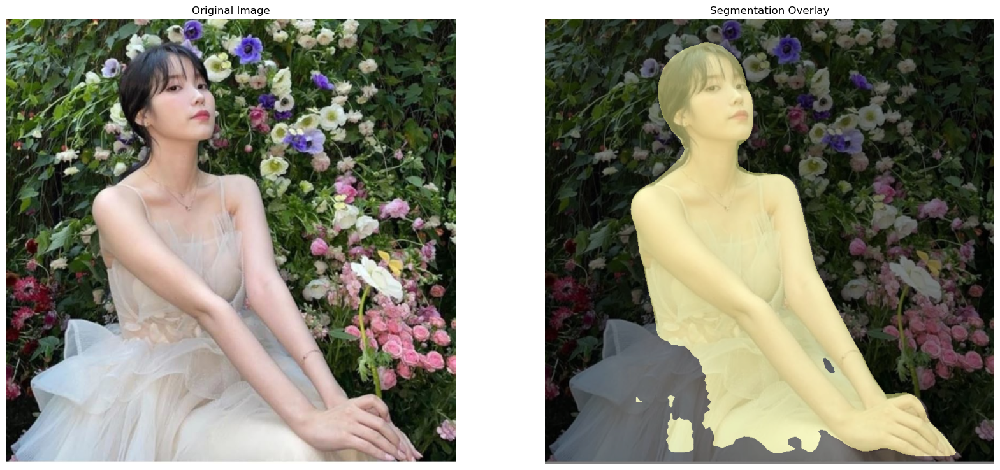

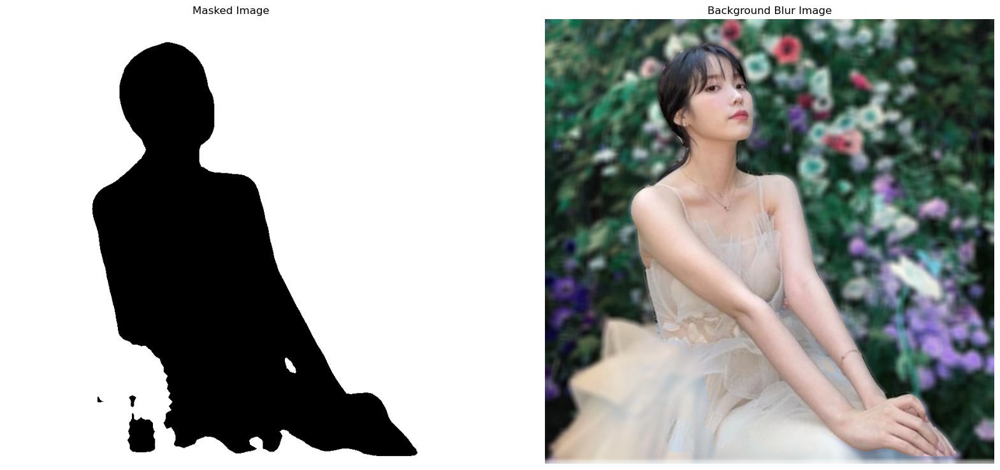

In [19]:
import torch
import torchvision
from torchvision import transforms

# 1. GPU 장치 설정
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# 2. 모델 로드 (DeepLabV3 with ResNet101 backbone) 및 GPU로 이동
model = torchvision.models.segmentation.deeplabv3_resnet101(pretrained=True).to(device)
model.eval()  # 모델을 평가 모드로 설정

import os
import urllib
import cv2
import numpy as np
from matplotlib import pyplot as plt

# os 모듈에 있는 getenv() 함수를 이용하여 읽고싶은 파일의 경로를 file_path에 저장
# 준비한 이미지 파일의 경로를 이용하여, 이미지 파일을 읽음
# cv2.imread(경로): 경로에 해당하는 이미지 파일을 읽어서 변수에 저장
img_path = os.getenv('HOME')+'/myworks/sample_image.jpg'  
img_orig = cv2.imread(img_path) 

# print(img_orig.shape)

# # cv2.cvtColor(입력 이미지, 색상 변환 코드): 입력 이미지의 색상 채널을 변경
# # cv2.COLOR_BGR2RGB: 이미지 색상 채널을 변경 (BGR 형식을 RGB 형식으로 변경)
# # plt.imshow(): 저장된 데이터를 이미지의 형식으로 표시, 입력은 RGB(A) 데이터 혹은 2D 스칼라 데이터
# # https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.imshow.html
# # plt.show(): 현재 열려있는 모든 figure를 표시 (여기서 figure는 이미지, 그래프 등)
# # https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.show.html
# plt.imshow(cv2.cvtColor(img_orig, cv2.COLOR_BGR2RGB))
# plt.show()

# 3. 이미지 전처리 함수
def preprocess(image_path):
    input_image = cv2.imread(image_path)
    if input_image is None:
        raise ValueError(f"Image at {image_path} could not be loaded.")
    input_image = cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB)  # OpenCV는 BGR을 사용하므로 RGB로 변환
    preprocess = transforms.Compose([
        transforms.ToTensor(),  # 이미지를 PyTorch 텐서로 변환
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),  # ImageNet 정규화
    ])
    input_tensor = preprocess(input_image)
    input_batch = input_tensor.unsqueeze(0).to(device)  # 배치 차원 추가 및 GPU로 이동
    return input_batch, input_image

# 4. 세그멘테이션 수행 함수
def perform_segmentation(model, input_batch):
    with torch.no_grad():
        output = model(input_batch)['out'][0]
    output_predictions = output.argmax(0).byte().cpu().numpy()  # 예측 결과를 numpy 배열로 변환
    return output_predictions

# 5. 결과 시각화 함수 (인물 색상을 노란색 계열로 설정)
def visualize_segmentation(original_image, seg_map, person_class=15):
    # 세그멘테이션 맵에서 인물 클래스(15번)를 노란색 계열로 설정
    person_overlay = np.zeros_like(original_image)
    person_overlay[seg_map == person_class] = [255, 255, 153]  # 옅은 노란색 (BGR)
    
    # 인물 외 다른 클래스는 기본 색상으로 설정
    seg_map_colored = cv2.applyColorMap(seg_map, cv2.COLORMAP_PINK)
    seg_map_colored[seg_map == person_class] = person_overlay[seg_map == person_class]

    # 원본 이미지와 오버레이 결합
    overlay = cv2.addWeighted(original_image, 0.5, seg_map_colored, 0.5, 0)
       
    # 결과 시각화
    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.title('Original Image')
    plt.imshow(original_image)
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.title('Segmentation Overlay')
    plt.imshow(overlay)
    plt.axis('off')
    
    plt.show()
    
    # 원본 이미지 블러처리
    original_image_blur = cv2.blur(original_image, (13,13)) # (13,13)은 blurring kernel size를 뜻합니다

    # 세그멘테이션 마스크 생성
    img_mask = (seg_map == person_class).astype(np.uint8) * 255  # 인물 클래스 외의 모든 영역을 마스크
    
    img_mask_color = cv2.cvtColor(img_mask, cv2.COLOR_GRAY2BGR)
    img_bg_mask = cv2.bitwise_not(img_mask_color)
    img_bg_blur = cv2.bitwise_and(original_image_blur, img_bg_mask)
    img_bg_blur = cv2.cvtColor(img_bg_blur, cv2.COLOR_BGR2RGB)
    img_concat = np.where(img_mask_color==255, original_image, img_bg_blur)

    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.title('Masked Image')
    plt.imshow(img_bg_mask)
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.title('Background Blur Image')
    plt.imshow(img_concat)
    plt.axis('off')
    plt.show()

# 6. 실행 예제
if __name__ == "__main__":
    # image_path = "sample_image.jpg"  # 세그멘테이션을 수행할 이미지 파일 경로
    
    # 전처리 및 세그멘테이션 수행
    input_batch, original_image = preprocess(img_path)
    seg_map = perform_segmentation(model, input_batch)
        
    # 결과 시각화
    visualize_segmentation(original_image, seg_map)


# Swin Transformer

In [20]:
import torch
from transformers import SwinForImageClassification, SwinConfig
from torchvision import transforms
import cv2
import numpy as np
from matplotlib import pyplot as plt

# 1. GPU 장치 설정
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# 2. Swin Transformer 모델 로드 및 GPU로 이동
config = SwinConfig(num_labels=21)  # 21 클래스 (예: PASCAL VOC 데이터셋 기준)
model = SwinForImageClassification(config).to(device)
model.eval()  # 모델을 평가 모드로 설정

Using device: cuda


SwinForImageClassification(
  (swin): SwinModel(
    (embeddings): SwinEmbeddings(
      (patch_embeddings): SwinPatchEmbeddings(
        (projection): Conv2d(3, 96, kernel_size=(4, 4), stride=(4, 4))
      )
      (norm): LayerNorm((96,), eps=1e-05, elementwise_affine=True)
      (dropout): Dropout(p=0.0, inplace=False)
    )
    (encoder): SwinEncoder(
      (layers): ModuleList(
        (0): SwinStage(
          (blocks): ModuleList(
            (0-1): 2 x SwinLayer(
              (layernorm_before): LayerNorm((96,), eps=1e-05, elementwise_affine=True)
              (attention): SwinAttention(
                (self): SwinSelfAttention(
                  (query): Linear(in_features=96, out_features=96, bias=True)
                  (key): Linear(in_features=96, out_features=96, bias=True)
                  (value): Linear(in_features=96, out_features=96, bias=True)
                  (dropout): Dropout(p=0.0, inplace=False)
                )
                (output): SwinSelfOutput(
  

In [21]:
# 3. 이미지 전처리 함수
def preprocess(image_path):
    input_image = cv2.imread(image_path)
    if input_image is None:
        raise ValueError(f"Image at {image_path} could not be loaded.")
    input_image = cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB)  # OpenCV는 BGR을 사용하므로 RGB로 변환
    preprocess = transforms.Compose([
        transforms.ToTensor(),  # 이미지를 PyTorch 텐서로 변환
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),  # ImageNet 정규화
    ])
    input_tensor = preprocess(input_image)
    input_batch = input_tensor.unsqueeze(0).to(device)  # 배치 차원 추가 및 GPU로 이동
    return input_batch, input_image

# 4. 세그멘테이션 수행 함수
def perform_segmentation(model, input_batch):
    with torch.no_grad():
        output = model(input_batch).logits  # Swin Transformer의 예측 결과
    output_predictions = output.argmax(1).squeeze(0).byte().cpu().numpy()  # 예측 결과를 numpy 배열로 변환
    return output_predictions

# 5. 결과 시각화 함수 (인물 색상을 노란색 계열로 설정)
def visualize_segmentation(original_image, seg_map, person_class=15):
    # 세그멘테이션 맵의 크기를 원본 이미지 크기에 맞게 조정
    seg_map_resized = cv2.resize(seg_map, (original_image.shape[1], original_image.shape[0]), interpolation=cv2.INTER_NEAREST)

    # seg_map_resized의 고유한 클래스 값 확인
    unique_classes = np.unique(seg_map_resized)
    print(f"Unique classes in segmentation map: {unique_classes}")

    if person_class not in unique_classes:
        print(f"Person class {person_class} not found in the segmentation map.")
        # 다른 클래스를 선택
        person_class = unique_classes[1] if len(unique_classes) > 1 else unique_classes[0]
        print(f"Using class {person_class} instead for visualization.")

    # 세그멘테이션 맵에서 인물 클래스(15번)를 노란색 계열로 설정
    person_overlay = np.zeros_like(original_image)
    person_mask = seg_map_resized == person_class
    person_overlay[person_mask] = [255, 255, 153]  # 옅은 노란색 (RGB)

    # 인물 외 다른 클래스는 기본 색상으로 설정
    seg_map_colored = cv2.applyColorMap((seg_map_resized * (255 // 21)).astype(np.uint8), cv2.COLORMAP_PINK)
    
    # person_overlay와 seg_map_colored의 크기와 shape이 맞는지 확인
    if person_overlay.shape == seg_map_colored.shape:
        seg_map_colored[person_mask] = person_overlay[person_mask]
    else:
        print("Shape mismatch between person_overlay and seg_map_colored")

    # 원본 이미지와 오버레이 결합
    overlay = cv2.addWeighted(original_image, 0.5, seg_map_colored, 0.5, 0)

    # 결과 시각화
    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.title('Original Image')
    plt.imshow(original_image)
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Segmentation Overlay')
    plt.imshow(overlay)
    plt.axis('off')

    plt.show()

    # 원본 이미지 블러처리
    original_image_blur = cv2.blur(original_image, (13,13))  # (13,13)은 blurring kernel size를 뜻합니다

    # 세그멘테이션 마스크 생성
    img_mask = (seg_map_resized == person_class).astype(np.uint8) * 255  # 인물 클래스 외의 모든 영역을 마스크
  
    # img_mask가 numpy 배열인지 확인
    if isinstance(img_mask, np.ndarray):
        print(f"img_mask shape: {img_mask.shape}, dtype: {img_mask.dtype}")
        if img_mask.ndim == 2:  # 2D 마스크 확인
            img_mask = np.expand_dims(img_mask, axis=-1)  # 채널 차원 추가
        img_mask = np.ascontiguousarray(img_mask)  # 연속된 메모리 배열로 변환
        img_mask_color = cv2.cvtColor(img_mask, cv2.COLOR_GRAY2BGR)  # 3D로 변환
        img_bg_mask = cv2.bitwise_not(img_mask_color)
        img_bg_blur = cv2.bitwise_and(original_image_blur, img_bg_mask)
        img_concat = np.where(img_mask_color == 255, original_image, img_bg_blur)
    else:
        print(f"Invalid img_mask type: {type(img_mask)}")
        print(f"img_mask value: {img_mask}")
        raise ValueError("img_mask is not a valid numpy array")

    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.title('Masked Image')
    plt.imshow(cv2.cvtColor(img_bg_mask, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.title('Background Blur Image')
    plt.imshow(cv2.cvtColor(img_concat, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

Unique classes in segmentation map: [16]
Person class 15 not found in the segmentation map.
Using class 16 instead for visualization.


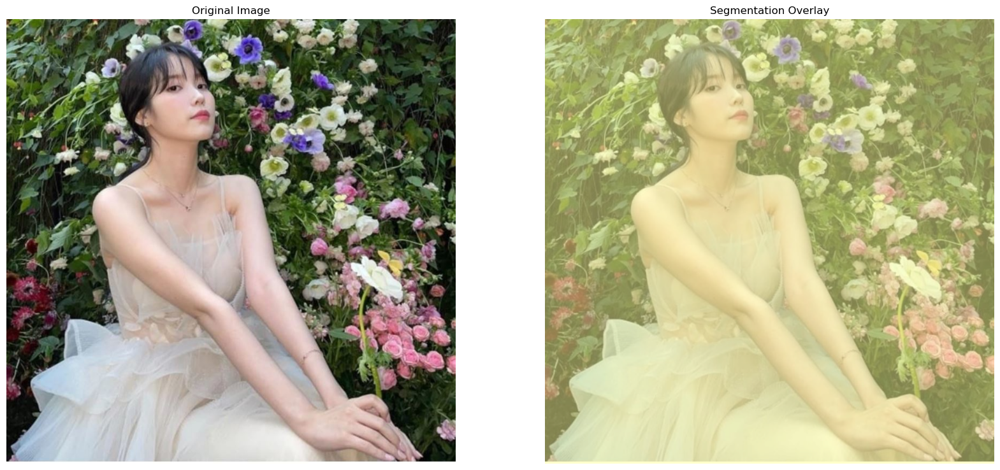

img_mask shape: (826, 834), dtype: uint8


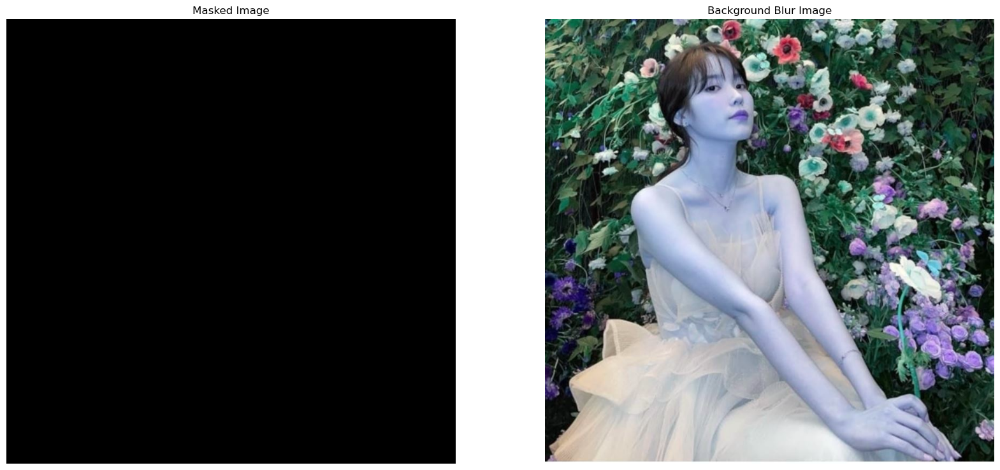

In [22]:
import os 

# 6. 실행 예제
if __name__ == "__main__":
    # 이미지 파일 경로
    img_path = os.getenv('HOME')+'/myworks/sample_image.jpg'  

    # 전처리 및 세그멘테이션 수행
    input_batch, original_image = preprocess(img_path)
    seg_map = perform_segmentation(model, input_batch)

    # 결과 시각화
    visualize_segmentation(original_image, seg_map)

# Auto Classes & SwinV2 & DeeplabV3_resnet50

Unique classes in segmentation map: [ 0 15]


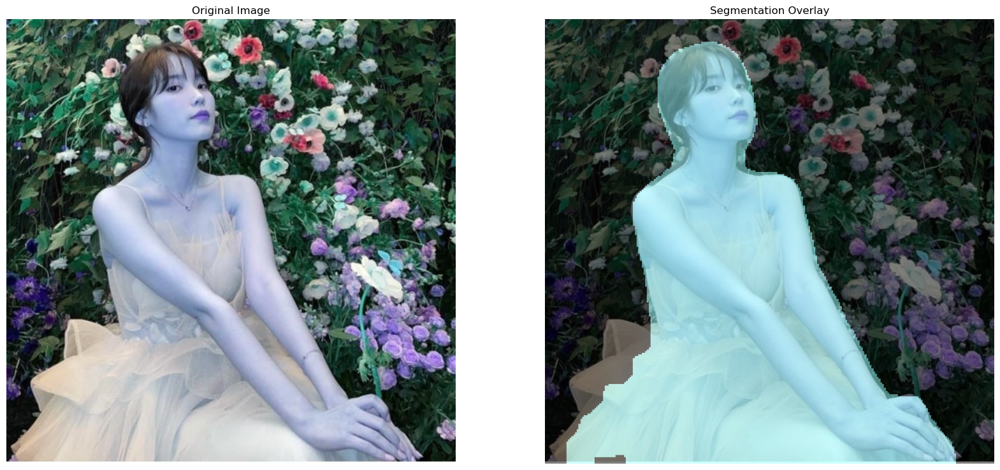

img_mask shape: (826, 834), dtype: uint8


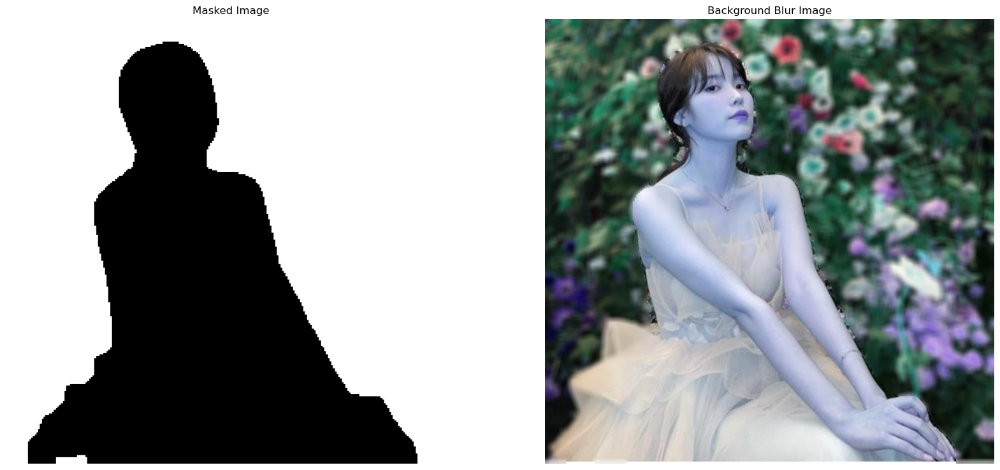

In [23]:
import torch
from transformers import AutoFeatureExtractor, AutoModelForImageClassification
from torchvision.models.segmentation import deeplabv3_resnet50
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import cv2  # OpenCV 추가
import os

def visualize_segmentation(original_image, seg_map, person_class=15):
    # 세그멘테이션 맵의 크기를 원본 이미지 크기에 맞게 조정
    seg_map_resized = cv2.resize(seg_map, (original_image.shape[1], original_image.shape[0]), interpolation=cv2.INTER_NEAREST)

    # seg_map_resized의 고유한 클래스 값 확인
    unique_classes = np.unique(seg_map_resized)
    print(f"Unique classes in segmentation map: {unique_classes}")

    if person_class not in unique_classes:
        print(f"Person class {person_class} not found in the segmentation map.")
        # 다른 클래스를 선택
        person_class = unique_classes[1] if len(unique_classes) > 1 else unique_classes[0]
        print(f"Using class {person_class} instead for visualization.")

    # 세그멘테이션 맵에서 인물 클래스(15번)를 노란색 계열로 설정
    person_overlay = np.zeros_like(original_image)
    person_mask = seg_map_resized == person_class
    person_overlay[person_mask] = [255, 255, 153]  # 옅은 노란색 (RGB)

    # 인물 외 다른 클래스는 기본 색상으로 설정
    seg_map_colored = cv2.applyColorMap((seg_map_resized * (255 // 21)).astype(np.uint8), cv2.COLORMAP_PINK)
    
    # person_overlay와 seg_map_colored의 크기와 shape이 맞는지 확인
    if person_overlay.shape == seg_map_colored.shape:
        seg_map_colored[person_mask] = person_overlay[person_mask]
    else:
        print("Shape mismatch between person_overlay and seg_map_colored")

    # 원본 이미지와 오버레이 결합
    overlay = cv2.addWeighted(original_image, 0.5, seg_map_colored, 0.5, 0)

    # 결과 시각화
    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.title('Original Image')
    plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Segmentation Overlay')
    plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.show()

    # 원본 이미지 블러처리
    original_image_blur = cv2.blur(original_image, (13,13))  # (13,13)은 blurring kernel size를 뜻합니다

    # 세그멘테이션 마스크 생성
    img_mask = (seg_map_resized == person_class).astype(np.uint8) * 255  # 인물 클래스 외의 모든 영역을 마스크
  
    # img_mask가 numpy 배열인지 확인
    if isinstance(img_mask, np.ndarray):
        print(f"img_mask shape: {img_mask.shape}, dtype: {img_mask.dtype}")
        if img_mask.ndim == 2:  # 2D 마스크 확인
            img_mask = np.expand_dims(img_mask, axis=-1)  # 채널 차원 추가
        img_mask = np.ascontiguousarray(img_mask)  # 연속된 메모리 배열로 변환
        img_mask_color = cv2.cvtColor(img_mask, cv2.COLOR_GRAY2BGR)  # 3D로 변환
        img_bg_mask = cv2.bitwise_not(img_mask_color)
        img_bg_blur = cv2.bitwise_and(original_image_blur, img_bg_mask)
        img_concat = np.where(img_mask_color == 255, original_image, img_bg_blur)
    else:
        print(f"Invalid img_mask type: {type(img_mask)}")
        print(f"img_mask value: {img_mask}")
        raise ValueError("img_mask is not a valid numpy array")

    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.title('Masked Image')
    plt.imshow(cv2.cvtColor(img_bg_mask, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.title('Background Blur Image')
    plt.imshow(cv2.cvtColor(img_concat, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

# 이미지 불러오기
image_path = os.getenv('HOME') + '/myworks/sample_image.jpg'  
image = Image.open(image_path).convert('RGB')
image_np = np.array(image)

# AutoFeatureExtractor와 Swinv2 모델을 사용하여 특징 추출
feature_extractor = AutoFeatureExtractor.from_pretrained("microsoft/swinv2-tiny-patch4-window8-256")
model = AutoModelForImageClassification.from_pretrained("microsoft/swinv2-tiny-patch4-window8-256")

inputs = feature_extractor(images=image, return_tensors="pt")
outputs = model(**inputs)

# Deeplabv3 모델을 로드
segmentation_model = deeplabv3_resnet50(pretrained=True)
segmentation_model.eval()

# 특징 추출 (Deeplabv3 모델에서 이미지 분류 결과 사용 안함)
with torch.no_grad():
    output = segmentation_model(inputs['pixel_values'])

# 사람 클래스에 해당하는 마스크를 가져오기 (보통 클래스 15번이 사람)
output_predictions = output['out'][0].argmax(0).cpu().numpy()

# 세그멘테이션 결과 시각화
visualize_segmentation(image_np, output_predictions)


# Auto Classes & SwinV2 & DeeplabV3_resnet101

Unique classes in segmentation map: [ 0 15]


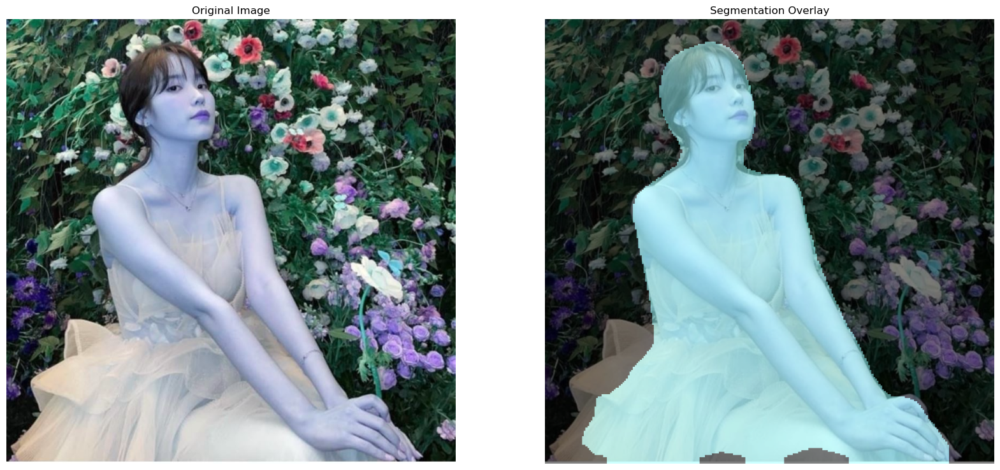

img_mask shape: (826, 834), dtype: uint8


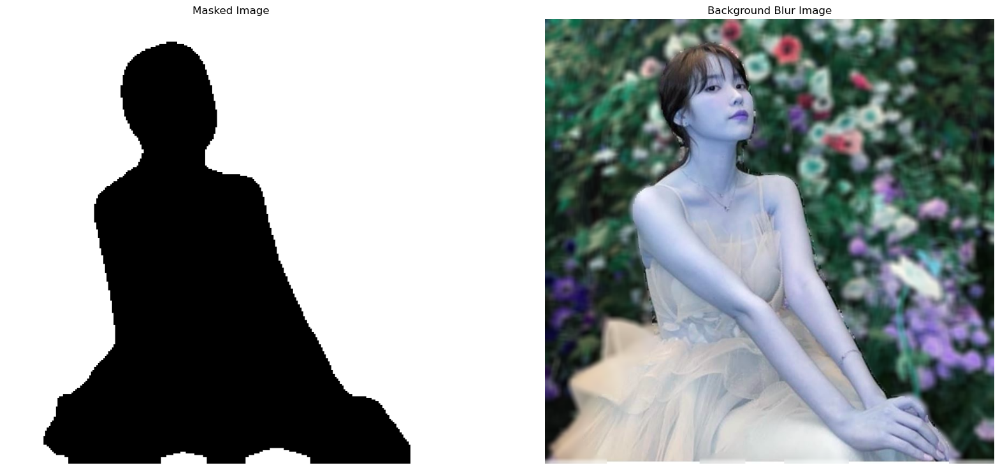

In [24]:
import torch
from transformers import AutoFeatureExtractor, AutoModelForImageClassification
from torchvision.models.segmentation import deeplabv3_resnet101  
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import cv2  # OpenCV 추가
import os

def visualize_segmentation(original_image, seg_map, person_class=15):
    # 세그멘테이션 맵의 크기를 원본 이미지 크기에 맞게 조정
    seg_map_resized = cv2.resize(seg_map, (original_image.shape[1], original_image.shape[0]), interpolation=cv2.INTER_NEAREST)

    # seg_map_resized의 고유한 클래스 값 확인
    unique_classes = np.unique(seg_map_resized)
    print(f"Unique classes in segmentation map: {unique_classes}")

    if person_class not in unique_classes:
        print(f"Person class {person_class} not found in the segmentation map.")
        # 다른 클래스를 선택
        person_class = unique_classes[1] if len(unique_classes) > 1 else unique_classes[0]
        print(f"Using class {person_class} instead for visualization.")

    # 세그멘테이션 맵에서 인물 클래스(15번)를 노란색 계열로 설정
    person_overlay = np.zeros_like(original_image)
    person_mask = seg_map_resized == person_class
    person_overlay[person_mask] = [255, 255, 153]  # 옅은 노란색 (RGB)

    # 인물 외 다른 클래스는 기본 색상으로 설정
    seg_map_colored = cv2.applyColorMap((seg_map_resized * (255 // 21)).astype(np.uint8), cv2.COLORMAP_PINK)
    
    # person_overlay와 seg_map_colored의 크기와 shape이 맞는지 확인
    if person_overlay.shape == seg_map_colored.shape:
        seg_map_colored[person_mask] = person_overlay[person_mask]
    else:
        print("Shape mismatch between person_overlay and seg_map_colored")

    # 원본 이미지와 오버레이 결합
    overlay = cv2.addWeighted(original_image, 0.5, seg_map_colored, 0.5, 0)

    # 결과 시각화
    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.title('Original Image')
    plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Segmentation Overlay')
    plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.show()

    # 원본 이미지 블러처리
    original_image_blur = cv2.blur(original_image, (13,13))  # (13,13)은 blurring kernel size를 뜻합니다

    # 세그멘테이션 마스크 생성
    img_mask = (seg_map_resized == person_class).astype(np.uint8) * 255  # 인물 클래스 외의 모든 영역을 마스크
  
    # img_mask가 numpy 배열인지 확인
    if isinstance(img_mask, np.ndarray):
        print(f"img_mask shape: {img_mask.shape}, dtype: {img_mask.dtype}")
        if img_mask.ndim == 2:  # 2D 마스크 확인
            img_mask = np.expand_dims(img_mask, axis=-1)  # 채널 차원 추가
        img_mask = np.ascontiguousarray(img_mask)  # 연속된 메모리 배열로 변환
        img_mask_color = cv2.cvtColor(img_mask, cv2.COLOR_GRAY2BGR)  # 3D로 변환
        img_bg_mask = cv2.bitwise_not(img_mask_color)
        img_bg_blur = cv2.bitwise_and(original_image_blur, img_bg_mask)
        img_concat = np.where(img_mask_color == 255, original_image, img_bg_blur)
    else:
        print(f"Invalid img_mask type: {type(img_mask)}")
        print(f"img_mask value: {img_mask}")
        raise ValueError("img_mask is not a valid numpy array")

    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.title('Masked Image')
    plt.imshow(cv2.cvtColor(img_bg_mask, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.title('Background Blur Image')
    plt.imshow(cv2.cvtColor(img_concat, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

# 이미지 불러오기
image_path = os.getenv('HOME') + '/myworks/sample_image.jpg'  
image = Image.open(image_path).convert('RGB')
image_np = np.array(image)

# AutoFeatureExtractor와 Swinv2 모델을 사용하여 특징 추출
feature_extractor = AutoFeatureExtractor.from_pretrained("microsoft/swinv2-tiny-patch4-window8-256")
model = AutoModelForImageClassification.from_pretrained("microsoft/swinv2-tiny-patch4-window8-256")

inputs = feature_extractor(images=image, return_tensors="pt")
outputs = model(**inputs)

# Deeplabv3 모델을 로드
segmentation_model = deeplabv3_resnet101(pretrained=True)
segmentation_model.eval()

# 특징 추출 (Deeplabv3 모델에서 이미지 분류 결과 사용 안함)
with torch.no_grad():
    output = segmentation_model(inputs['pixel_values'])

# 사람 클래스에 해당하는 마스크를 가져오기 (보통 클래스 15번이 사람)
output_predictions = output['out'][0].argmax(0).cpu().numpy()

# 세그멘테이션 결과 시각화
visualize_segmentation(image_np, output_predictions)


# DeeplabV3 with Xception Backbone

**mmcv라이브러리 설치 진행불가**

In [16]:
import mmcv
from mmseg.apis import init_segmentor, inference_segmentor
import matplotlib.pyplot as plt
import os
from PIL import Image
import numpy as np
import cv2

# DeeplabV3+ with Xception 설정 파일과 사전 학습된 모델 파일 경로
config_file = 'https://github.com/open-mmlab/mmsegmentation/blob/master/configs/deeplabv3plus/deeplabv3plus_xception-d8_512x1024_80k_cityscapes.py'
checkpoint_file = 'https://download.openmmlab.com/mmsegmentation/v0.5/deeplabv3plus/deeplabv3plus_xception-d8_512x1024_80k_cityscapes/deeplabv3plus_xception-d8_512x1024_80k_cityscapes_20200615_160000-09ed2a53.pth'

# 모델 초기화
model = init_segmentor(config_file, checkpoint_file, device='cuda:0')

# 테스트 이미지 로드
image_path = os.getenv('HOME') + '/myworks/sample_image.jpg'
result = inference_segmentor(model, image_path)

# 시각화
image = np.array(Image.open(image_path).convert('RGB'))
seg_map = result[0]

def visualize_segmentation(original_image, seg_map, person_class=15):
    # 세그멘테이션 맵의 크기를 원본 이미지 크기에 맞게 조정
    seg_map_resized = cv2.resize(seg_map, (original_image.shape[1], original_image.shape[0]), interpolation=cv2.INTER_NEAREST)

    # seg_map_resized의 고유한 클래스 값 확인
    unique_classes = np.unique(seg_map_resized)
    print(f"Unique classes in segmentation map: {unique_classes}")

    if person_class not in unique_classes:
        print(f"Person class {person_class} not found in the segmentation map.")
        # 다른 클래스를 선택
        person_class = unique_classes[1] if len(unique_classes) > 1 else unique_classes[0]
        print(f"Using class {person_class} instead for visualization.")

    # 세그멘테이션 맵에서 인물 클래스(15번)를 노란색 계열로 설정
    person_overlay = np.zeros_like(original_image)
    person_mask = seg_map_resized == person_class
    person_overlay[person_mask] = [255, 255, 153]  # 옅은 노란색 (RGB)

    # 인물 외 다른 클래스는 기본 색상으로 설정
    seg_map_colored = cv2.applyColorMap((seg_map_resized * (255 // 21)).astype(np.uint8), cv2.COLORMAP_PINK)
    
    # person_overlay와 seg_map_colored의 크기와 shape이 맞는지 확인
    if person_overlay.shape == seg_map_colored.shape:
        seg_map_colored[person_mask] = person_overlay[person_mask]
    else:
        print("Shape mismatch between person_overlay and seg_map_colored")

    # 원본 이미지와 오버레이 결합
    overlay = cv2.addWeighted(original_image, 0.5, seg_map_colored, 0.5, 0)

    # 결과 시각화
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title('Original Image')
    plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Segmentation Overlay')
    plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.show()

    # 원본 이미지 블러처리
    original_image_blur = cv2.blur(original_image, (13,13))  # (13,13)은 blurring kernel size를 뜻합니다

    # 세그멘테이션 마스크 생성
    img_mask = (seg_map_resized == person_class).astype(np.uint8) * 255  # 인물 클래스 외의 모든 영역을 마스크
  
    # img_mask가 numpy 배열인지 확인
    if isinstance(img_mask, np.ndarray):
        print(f"img_mask shape: {img_mask.shape}, dtype: {img_mask.dtype}")
        if img_mask.ndim == 2:  # 2D 마스크 확인
            img_mask = np.expand_dims(img_mask, axis=-1)  # 채널 차원 추가
        img_mask = np.ascontiguousarray(img_mask)  # 연속된 메모리 배열로 변환
        img_mask_color = cv2.cvtColor(img_mask, cv2.COLOR_GRAY2BGR)  # 3D로 변환
        img_bg_mask = cv2.bitwise_not(img_mask_color)
        img_bg_blur = cv2.bitwise_and(original_image_blur, img_bg_mask)
        img_concat = np.where(img_mask_color == 255, original_image, img_bg_blur)
    else:
        print(f"Invalid img_mask type: {type(img_mask)}")
        print(f"img_mask value: {img_mask}")
        raise ValueError("img_mask is not a valid numpy array")

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title('Masked Image')
    plt.imshow(cv2.cvtColor(img_bg_mask, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.title('Background Blur Image')
    plt.imshow(cv2.cvtColor(img_concat, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

# 시각화 함수 호출
visualize_segmentation(image, seg_map)


ModuleNotFoundError: No module named 'mmcv'

# EfficientNet Segmentation

Loaded pretrained weights for efficientnet-b0
Unique classes in segmentation map: [ 0  2  7  8 10 11 14 16 17 18 19]
Person class 15 not found in the segmentation map.
Using class 2 instead for visualization.


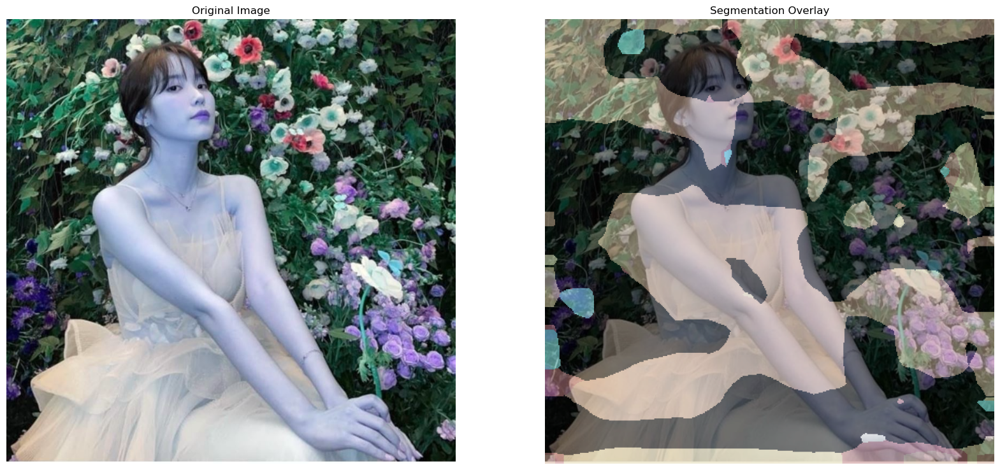

img_mask shape: (826, 834), dtype: uint8


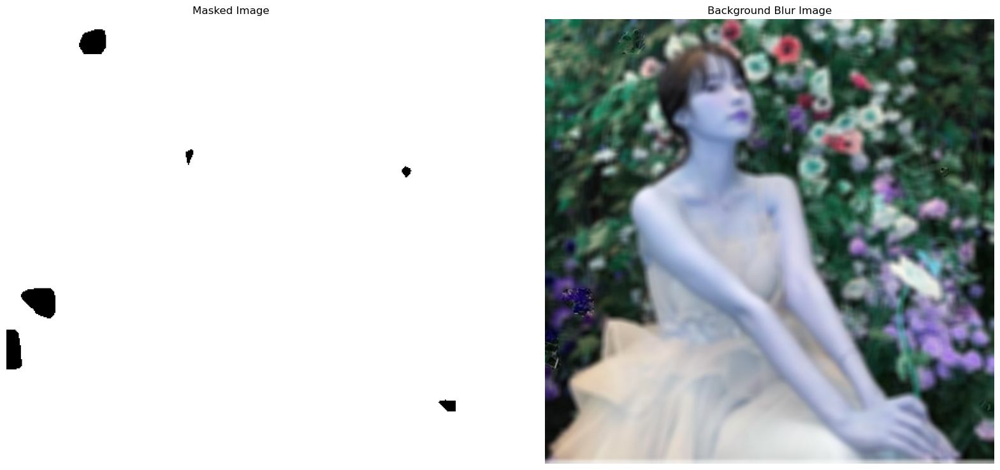

In [30]:
import torch
from torch import nn
from torchvision.models.segmentation import deeplabv3_resnet101
from efficientnet_pytorch import EfficientNet
import numpy as np
import cv2
import matplotlib.pyplot as plt
from PIL import Image
import os

# EfficientNet을 백본으로 하는 DeeplabV3 유사 모델 정의
class EfficientNetBackbone(nn.Module):
    def __init__(self, backbone_name='efficientnet-b0', out_channels=256):
        super(EfficientNetBackbone, self).__init__()
        self.backbone = EfficientNet.from_pretrained(backbone_name)
        self.out_channels = 1280  # EfficientNet의 출력 채널 수

    def forward(self, x):
        # EfficientNet의 여러 레이어에서 피처맵을 가져옴
        features = self.backbone.extract_features(x)
        return features

class DeeplabV3_EfficientNet(nn.Module):
    def __init__(self, num_classes=21, backbone_name='efficientnet-b0'):
        super(DeeplabV3_EfficientNet, self).__init__()
        self.backbone = EfficientNetBackbone(backbone_name=backbone_name)
        self.classifier = nn.Conv2d(self.backbone.out_channels, num_classes, kernel_size=1)
        self.upsample = nn.Upsample(scale_factor=16, mode='bilinear', align_corners=False)

    def forward(self, x):
        x = self.backbone(x)
        x = self.classifier(x)
        x = self.upsample(x)
        return x

# 모델 초기화
model = DeeplabV3_EfficientNet(num_classes=21, backbone_name='efficientnet-b0').eval()

# 이미지 불러오기
image_path = os.getenv('HOME') + '/myworks/sample_image.jpg'
image = Image.open(image_path).convert('RGB')
image_np = np.array(image)
image_tensor = torch.tensor(image_np).permute(2, 0, 1).unsqueeze(0).float()

# 모델 예측
with torch.no_grad():
    output = model(image_tensor)
output_predictions = output.argmax(1).squeeze(0).cpu().numpy()

# 세그멘테이션 결과 시각화
def visualize_segmentation(original_image, seg_map, person_class=15):
    # 세그멘테이션 맵의 크기를 원본 이미지 크기에 맞게 조정
    seg_map_resized = cv2.resize(seg_map, (original_image.shape[1], original_image.shape[0]), interpolation=cv2.INTER_NEAREST)

    # seg_map_resized의 고유한 클래스 값 확인
    unique_classes = np.unique(seg_map_resized)
    print(f"Unique classes in segmentation map: {unique_classes}")

    if person_class not in unique_classes:
        print(f"Person class {person_class} not found in the segmentation map.")
        # 다른 클래스를 선택
        person_class = unique_classes[1] if len(unique_classes) > 1 else unique_classes[0]
        print(f"Using class {person_class} instead for visualization.")

    # 세그멘테이션 맵에서 인물 클래스(15번)를 노란색 계열로 설정
    person_overlay = np.zeros_like(original_image)
    person_mask = seg_map_resized == person_class
    person_overlay[person_mask] = [255, 255, 153]  # 옅은 노란색 (RGB)

    # 인물 외 다른 클래스는 기본 색상으로 설정
    seg_map_colored = cv2.applyColorMap((seg_map_resized * (255 // 21)).astype(np.uint8), cv2.COLORMAP_PINK)
    
    # person_overlay와 seg_map_colored의 크기와 shape이 맞는지 확인
    if person_overlay.shape == seg_map_colored.shape:
        seg_map_colored[person_mask] = person_overlay[person_mask]
    else:
        print("Shape mismatch between person_overlay and seg_map_colored")

    # 원본 이미지와 오버레이 결합
    overlay = cv2.addWeighted(original_image, 0.5, seg_map_colored, 0.5, 0)

    # 결과 시각화
    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.title('Original Image')
    plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Segmentation Overlay')
    plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.show()

    # 원본 이미지 블러처리
    original_image_blur = cv2.blur(original_image, (13,13))  # (13,13)은 blurring kernel size를 뜻합니다

    # 세그멘테이션 마스크 생성
    img_mask = (seg_map_resized == person_class).astype(np.uint8) * 255  # 인물 클래스 외의 모든 영역을 마스크
  
    # img_mask가 numpy 배열인지 확인
    if isinstance(img_mask, np.ndarray):
        print(f"img_mask shape: {img_mask.shape}, dtype: {img_mask.dtype}")
        if img_mask.ndim == 2:  # 2D 마스크 확인
            img_mask = np.expand_dims(img_mask, axis=-1)  # 채널 차원 추가
        img_mask = np.ascontiguousarray(img_mask)  # 연속된 메모리 배열로 변환
        img_mask_color = cv2.cvtColor(img_mask, cv2.COLOR_GRAY2BGR)  # 3D로 변환
        img_bg_mask = cv2.bitwise_not(img_mask_color)
        img_bg_blur = cv2.bitwise_and(original_image_blur, img_bg_mask)
        img_concat = np.where(img_mask_color == 255, original_image, img_bg_blur)
    else:
        print(f"Invalid img_mask type: {type(img_mask)}")
        print(f"img_mask value: {img_mask}")
        raise ValueError("img_mask is not a valid numpy array")

    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.title('Masked Image')
    plt.imshow(cv2.cvtColor(img_bg_mask, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.title('Background Blur Image')
    plt.imshow(cv2.cvtColor(img_concat, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

# 시각화 함수 호출
visualize_segmentation(image_np, output_predictions)


# EfficientNet Segmentation : efficientnet-b7

Loaded pretrained weights for efficientnet-b7
Unique classes in segmentation map: [ 0  2  3  4  7  8  9 10 12 13 14 15 17 18 19 20]


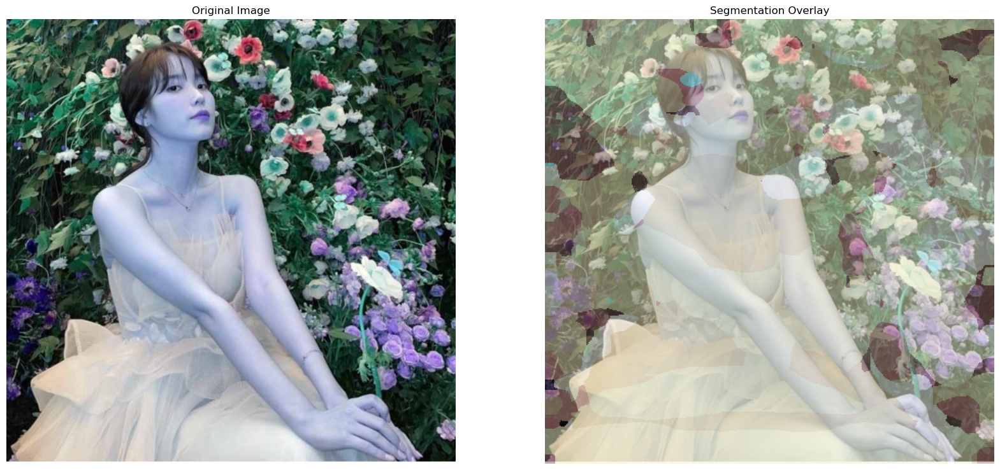

img_mask shape: (826, 834), dtype: uint8


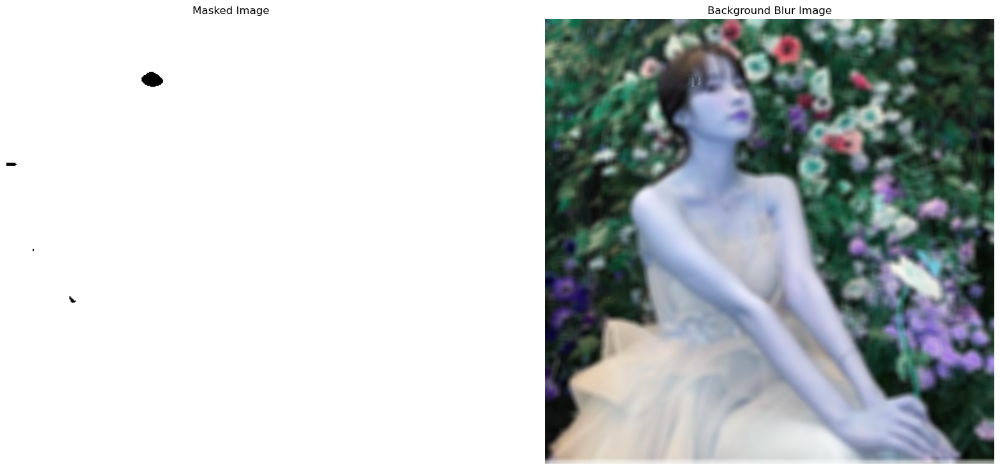

In [33]:
import torch
from torch import nn
from torchvision.models.segmentation import deeplabv3_resnet101
from efficientnet_pytorch import EfficientNet
import numpy as np
import cv2
import matplotlib.pyplot as plt
from PIL import Image
import os

# EfficientNet을 백본으로 하는 DeeplabV3 유사 모델 정의
class EfficientNetBackbone(nn.Module):
    def __init__(self, backbone_name='efficientnet-b7', out_channels=256):
        super(EfficientNetBackbone, self).__init__()
        self.backbone = EfficientNet.from_pretrained(backbone_name)
        self.out_channels = 2560   # efficientnet-b7의 출력 채널 수

    def forward(self, x):
        # EfficientNet의 여러 레이어에서 피처맵을 가져옴
        features = self.backbone.extract_features(x)
        return features

class DeeplabV3_EfficientNet(nn.Module):
    def __init__(self, num_classes=21, backbone_name='efficientnet-b7'):
        super(DeeplabV3_EfficientNet, self).__init__()
        self.backbone = EfficientNetBackbone(backbone_name=backbone_name)
        self.classifier = nn.Conv2d(self.backbone.out_channels, num_classes, kernel_size=1)
        self.upsample = nn.Upsample(scale_factor=16, mode='bilinear', align_corners=False)

    def forward(self, x):
        x = self.backbone(x)
        x = self.classifier(x)
        x = self.upsample(x)
        return x

# 모델 초기화
model = DeeplabV3_EfficientNet(num_classes=21, backbone_name='efficientnet-b7').eval()

# 이미지 불러오기
image_path = os.getenv('HOME') + '/myworks/sample_image.jpg'
image = Image.open(image_path).convert('RGB')
image_np = np.array(image)
image_tensor = torch.tensor(image_np).permute(2, 0, 1).unsqueeze(0).float()

# 모델 예측
with torch.no_grad():
    output = model(image_tensor)
output_predictions = output.argmax(1).squeeze(0).cpu().numpy()

# 세그멘테이션 결과 시각화
def visualize_segmentation(original_image, seg_map, person_class=15):
    # 세그멘테이션 맵의 크기를 원본 이미지 크기에 맞게 조정
    seg_map_resized = cv2.resize(seg_map, (original_image.shape[1], original_image.shape[0]), interpolation=cv2.INTER_NEAREST)

    # seg_map_resized의 고유한 클래스 값 확인
    unique_classes = np.unique(seg_map_resized)
    print(f"Unique classes in segmentation map: {unique_classes}")

    if person_class not in unique_classes:
        print(f"Person class {person_class} not found in the segmentation map.")
        # 다른 클래스를 선택
        person_class = unique_classes[1] if len(unique_classes) > 1 else unique_classes[0]
        print(f"Using class {person_class} instead for visualization.")

    # 세그멘테이션 맵에서 인물 클래스(15번)를 노란색 계열로 설정
    person_overlay = np.zeros_like(original_image)
    person_mask = seg_map_resized == person_class
    person_overlay[person_mask] = [255, 255, 153]  # 옅은 노란색 (RGB)

    # 인물 외 다른 클래스는 기본 색상으로 설정
    seg_map_colored = cv2.applyColorMap((seg_map_resized * (255 // 21)).astype(np.uint8), cv2.COLORMAP_PINK)
    
    # person_overlay와 seg_map_colored의 크기와 shape이 맞는지 확인
    if person_overlay.shape == seg_map_colored.shape:
        seg_map_colored[person_mask] = person_overlay[person_mask]
    else:
        print("Shape mismatch between person_overlay and seg_map_colored")

    # 원본 이미지와 오버레이 결합
    overlay = cv2.addWeighted(original_image, 0.5, seg_map_colored, 0.5, 0)

    # 결과 시각화
    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.title('Original Image')
    plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Segmentation Overlay')
    plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.show()

    # 원본 이미지 블러처리
    original_image_blur = cv2.blur(original_image, (13,13))  # (13,13)은 blurring kernel size를 뜻합니다

    # 세그멘테이션 마스크 생성
    img_mask = (seg_map_resized == person_class).astype(np.uint8) * 255  # 인물 클래스 외의 모든 영역을 마스크
  
    # img_mask가 numpy 배열인지 확인
    if isinstance(img_mask, np.ndarray):
        print(f"img_mask shape: {img_mask.shape}, dtype: {img_mask.dtype}")
        if img_mask.ndim == 2:  # 2D 마스크 확인
            img_mask = np.expand_dims(img_mask, axis=-1)  # 채널 차원 추가
        img_mask = np.ascontiguousarray(img_mask)  # 연속된 메모리 배열로 변환
        img_mask_color = cv2.cvtColor(img_mask, cv2.COLOR_GRAY2BGR)  # 3D로 변환
        img_bg_mask = cv2.bitwise_not(img_mask_color)
        img_bg_blur = cv2.bitwise_and(original_image_blur, img_bg_mask)
        img_concat = np.where(img_mask_color == 255, original_image, img_bg_blur)
    else:
        print(f"Invalid img_mask type: {type(img_mask)}")
        print(f"img_mask value: {img_mask}")
        raise ValueError("img_mask is not a valid numpy array")

    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.title('Masked Image')
    plt.imshow(cv2.cvtColor(img_bg_mask, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.title('Background Blur Image')
    plt.imshow(cv2.cvtColor(img_concat, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

# 시각화 함수 호출
visualize_segmentation(image_np, output_predictions, person_class=15)


#  Auto Classes & SwinV2 & DeeplabV3_resnet50 w. CRF (Conditional Random Fields) 후처리

Unique classes in segmentation map: [ 0 15]


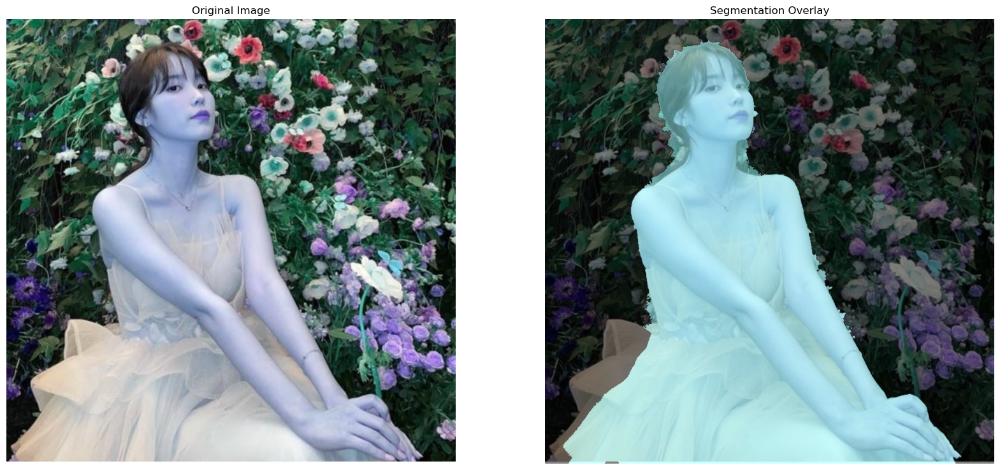

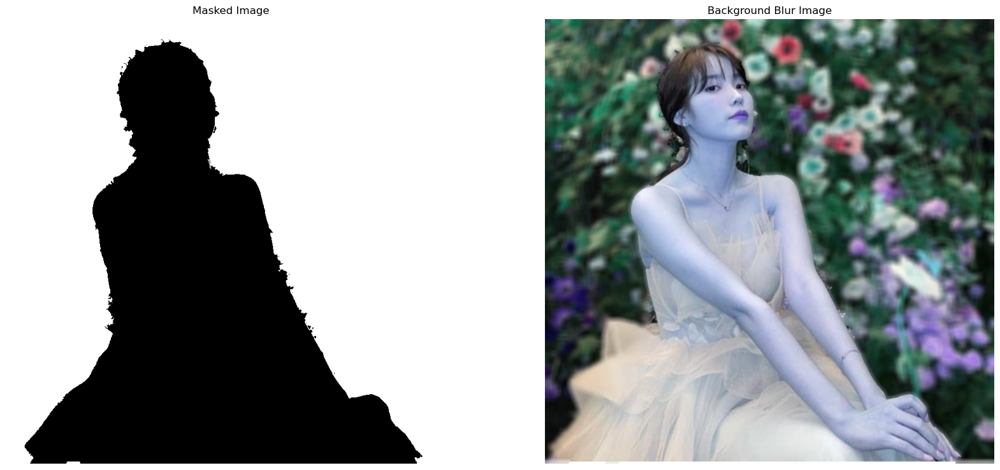

In [39]:
import torch
from transformers import AutoFeatureExtractor, AutoModelForImageClassification
from torchvision.models.segmentation import deeplabv3_resnet50
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import cv2  # OpenCV 추가
import os
import pydensecrf.densecrf as dcrf
from pydensecrf.utils import unary_from_softmax, create_pairwise_gaussian, create_pairwise_bilateral

def visualize_segmentation(original_image, seg_map, person_class=15):
    seg_map_resized = cv2.resize(seg_map, (original_image.shape[1], original_image.shape[0]), interpolation=cv2.INTER_NEAREST)
    unique_classes = np.unique(seg_map_resized)
    print(f"Unique classes in segmentation map: {unique_classes}")

    if person_class not in unique_classes:
        print(f"Person class {person_class} not found in the segmentation map.")
        person_class = unique_classes[1] if len(unique_classes) > 1 else unique_classes[0]
        print(f"Using class {person_class} instead for visualization.")

    person_overlay = np.zeros_like(original_image)
    person_mask = seg_map_resized == person_class
    person_overlay[person_mask] = [255, 255, 153]

    seg_map_colored = cv2.applyColorMap((seg_map_resized * (255 // 21)).astype(np.uint8), cv2.COLORMAP_PINK)
    
    if person_overlay.shape == seg_map_colored.shape:
        seg_map_colored[person_mask] = person_overlay[person_mask]

    overlay = cv2.addWeighted(original_image, 0.5, seg_map_colored, 0.5, 0)

    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.title('Original Image')
    plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Segmentation Overlay')
    plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.show()

    original_image_blur = cv2.blur(original_image, (13,13))

    img_mask = (seg_map_resized == person_class).astype(np.uint8) * 255
  
    if isinstance(img_mask, np.ndarray):
        if img_mask.ndim == 2:
            img_mask = np.expand_dims(img_mask, axis=-1)
        img_mask = np.ascontiguousarray(img_mask)
        img_mask_color = cv2.cvtColor(img_mask, cv2.COLOR_GRAY2BGR)
        img_bg_mask = cv2.bitwise_not(img_mask_color)
        img_bg_blur = cv2.bitwise_and(original_image_blur, img_bg_mask)
        img_concat = np.where(img_mask_color == 255, original_image, img_bg_blur)

    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.title('Masked Image')
    plt.imshow(cv2.cvtColor(img_bg_mask, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.title('Background Blur Image')
    plt.imshow(cv2.cvtColor(img_concat, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

def apply_crf(image, output_logits):
    h, w = image.shape[:2]
    n_labels = output_logits.shape[0]

    d = dcrf.DenseCRF2D(w, h, n_labels)

    # Unary term
    unary = unary_from_softmax(np.ascontiguousarray(output_logits))
    d.setUnaryEnergy(unary)

    feats = create_pairwise_gaussian((3, 3), (h, w))
    d.addPairwiseEnergy(feats, compat=3)

    feats = create_pairwise_bilateral(sdims=(10, 10), schan=(13, 13, 13), img=image, chdim=2)
    d.addPairwiseEnergy(feats, compat=10)

    Q = d.inference(5)
    result = np.argmax(Q, axis=0).reshape((h, w))
    return result

# 이미지 불러오기
image_path = os.getenv('HOME') + '/myworks/sample_image.jpg'  
image = Image.open(image_path).convert('RGB')
image_np = np.array(image)

# AutoFeatureExtractor와 Swinv2 모델을 사용하여 특징 추출
feature_extractor = AutoFeatureExtractor.from_pretrained("microsoft/swinv2-tiny-patch4-window8-256")
model = AutoModelForImageClassification.from_pretrained("microsoft/swinv2-tiny-patch4-window8-256")

inputs = feature_extractor(images=image, return_tensors="pt")
outputs = model(**inputs)

# Deeplabv3 모델을 로드
segmentation_model = deeplabv3_resnet50(pretrained=True)
segmentation_model.eval()

# 입력 이미지 크기에 맞는 특징 추출 (Deeplabv3 모델에서 이미지 분류 결과 사용 안함)
with torch.no_grad():
    output = segmentation_model(inputs['pixel_values'])

# CRF에 입력할 logits 크기 조정
output_softmax = torch.nn.functional.softmax(output['out'][0], dim=0).cpu().numpy()
output_softmax = cv2.resize(output_softmax.transpose(1, 2, 0), (image_np.shape[1], image_np.shape[0]))
output_softmax = output_softmax.transpose(2, 0, 1)

# CRF 후처리 적용
crf_result = apply_crf(image_np, output_softmax)

# 세그멘테이션 결과 시각화
visualize_segmentation(image_np, crf_result)


#  Auto Classes & SwinV2 & DeeplabV3_resnet50 w. Morphological Operations (형태학적 연산) 후처리

Unique classes in segmentation map: [ 0 15]


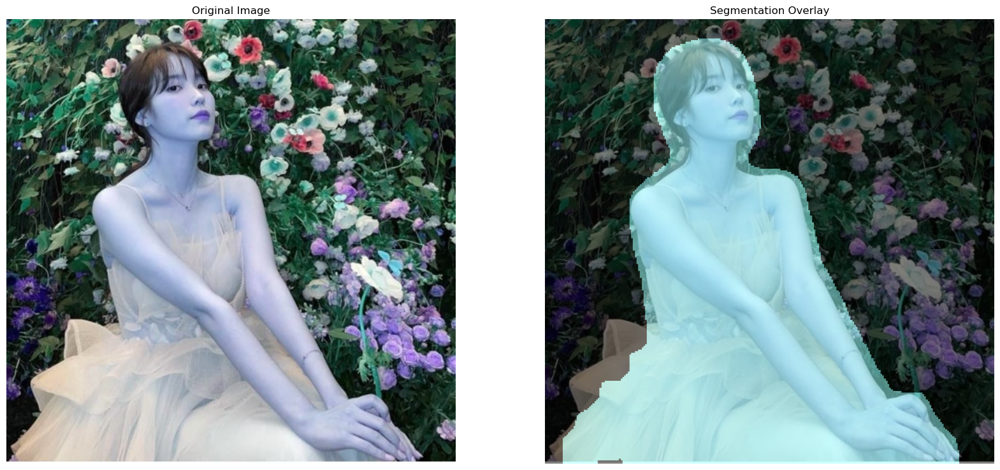

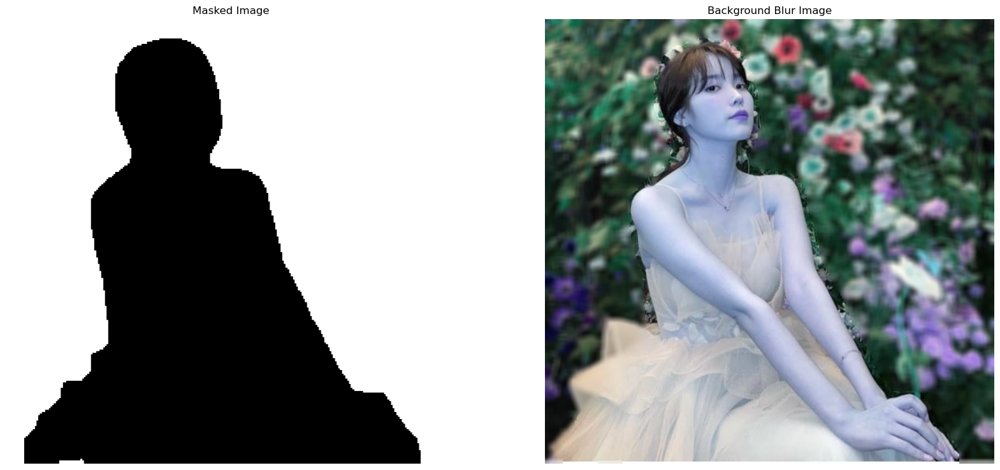

In [40]:
import torch
from transformers import AutoFeatureExtractor, AutoModelForImageClassification
from torchvision.models.segmentation import deeplabv3_resnet50
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import cv2  # OpenCV 추가
import os

def visualize_segmentation(original_image, seg_map, person_class=15):
    seg_map_resized = cv2.resize(seg_map, (original_image.shape[1], original_image.shape[0]), interpolation=cv2.INTER_NEAREST)
    unique_classes = np.unique(seg_map_resized)
    print(f"Unique classes in segmentation map: {unique_classes}")

    if person_class not in unique_classes:
        print(f"Person class {person_class} not found in the segmentation map.")
        person_class = unique_classes[1] if len(unique_classes) > 1 else unique_classes[0]
        print(f"Using class {person_class} instead for visualization.")

    person_overlay = np.zeros_like(original_image)
    person_mask = seg_map_resized == person_class
    person_overlay[person_mask] = [255, 255, 153]

    seg_map_colored = cv2.applyColorMap((seg_map_resized * (255 // 21)).astype(np.uint8), cv2.COLORMAP_PINK)
    
    if person_overlay.shape == seg_map_colored.shape:
        seg_map_colored[person_mask] = person_overlay[person_mask]

    overlay = cv2.addWeighted(original_image, 0.5, seg_map_colored, 0.5, 0)

    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.title('Original Image')
    plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Segmentation Overlay')
    plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.show()

    original_image_blur = cv2.blur(original_image, (13,13))

    img_mask = (seg_map_resized == person_class).astype(np.uint8) * 255
  
    if isinstance(img_mask, np.ndarray):
        if img_mask.ndim == 2:
            img_mask = np.expand_dims(img_mask, axis=-1)
        img_mask = np.ascontiguousarray(img_mask)
        img_mask_color = cv2.cvtColor(img_mask, cv2.COLOR_GRAY2BGR)
        img_bg_mask = cv2.bitwise_not(img_mask_color)
        img_bg_blur = cv2.bitwise_and(original_image_blur, img_bg_mask)
        img_concat = np.where(img_mask_color == 255, original_image, img_bg_blur)

    plt.figure(figsize=(20, 10))
    plt.subplot(1, 2, 1)
    plt.title('Masked Image')
    plt.imshow(cv2.cvtColor(img_bg_mask, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.title('Background Blur Image')
    plt.imshow(cv2.cvtColor(img_concat, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

def apply_morphology(segmentation_map, kernel_size=5, operation='dilate'):
    kernel = np.ones((kernel_size, kernel_size), np.uint8)
    if operation == 'dilate':
        return cv2.dilate(segmentation_map.astype(np.uint8), kernel, iterations=1)
    elif operation == 'erode':
        return cv2.erode(segmentation_map.astype(np.uint8), kernel, iterations=1)
    return segmentation_map

# 이미지 불러오기
image_path = os.getenv('HOME') + '/myworks/sample_image.jpg'  
image = Image.open(image_path).convert('RGB')
image_np = np.array(image)

# AutoFeatureExtractor와 Swinv2 모델을 사용하여 특징 추출
feature_extractor = AutoFeatureExtractor.from_pretrained("microsoft/swinv2-tiny-patch4-window8-256")
model = AutoModelForImageClassification.from_pretrained("microsoft/swinv2-tiny-patch4-window8-256")

inputs = feature_extractor(images=image, return_tensors="pt")
outputs = model(**inputs)

# Deeplabv3 모델을 로드
segmentation_model = deeplabv3_resnet50(pretrained=True)
segmentation_model.eval()

# 특징 추출 (Deeplabv3 모델에서 이미지 분류 결과 사용 안함)
with torch.no_grad():
    output = segmentation_model(inputs['pixel_values'])

# 사람 클래스에 해당하는 마스크를 가져오기 (보통 클래스 15번이 사람)
output_predictions = output['out'][0].argmax(0).cpu().numpy()

# Morphological Operations 적용
morphed_output = apply_morphology(output_predictions, kernel_size=5, operation='dilate')

# 세그멘테이션 결과 시각화
visualize_segmentation(image_np, morphed_output)


# 요약

**DeepLabV3 with ResNet101 backbone**
- 분류 잘함
- 사람 경계 구분이 매우 탁월함
- 한계: 아웃포커싱된 옷의 일부분 인식 못함

**Swin Transformer**
- 분류를 못함

**Auto Classes & SwinV2 & DeeplabV3_resnet50**
- 분류 잘함
- 사람 경계 구분은 다소 투박함
- DeepLabV3 with ResNet101 보다는 옷의 미인식 부분이 개선됨

**Auto Classes & SwinV2 & DeeplabV3_resnet101**
- 분류 잘함
- 사람 경계 구분은 다소 투박함
- DeepLabV3 with ResNet101 보다는 옷의 미인식 부분이 개선되었으나, Auto Classes & SwinV2 & DeeplabV3_resnet50 보다 개선된 측면은 없음

**EfficientNet Segmentation**
- 분류 잘 못함
- 사람 경계 마스킹이 안됨

**[v]uto Classes & SwinV2 & DeeplabV3_resnet50 w. CRF (Conditional Random Fields) 후처리**
- 경계선이 더 개선됨
- 한계: 경계선이 다소 지저분하게 masking 된 부분이 남아 있음

**Auto Classes & SwinV2 & DeeplabV3_resnet50 w. Morphological Operations (형태학적 연산) 후처리**
- 경계선이 더 투박하게 되어버림